<h1 align="center">PSG COLLEGE OF TECHNOLOGY</h1> 
<h2 align="center">AMCS</h2> 
<h2 align="center">DATA VISUALISATION FINAL PACKAGE</h2> 
<h1 align="center">18XD46</h1> </br>
<h1 align="left">Title    :    Avocado : A case study!</h1> 

### By :
### - 19PD05 ~ P Alagu Prakalya
### - 19PD19 ~ V Krithika

### Source :     https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json
###                     https://www.kaggle.com/neuromusic/avocado-prices


<div>
<img src="tenor.gif"/>
</div>

### In the following section we will be performing an exploratory data analysis and create an interactive dashboard using dash-plotly on the given avocado-price dataset grouped by ,</br>
- Region in the United States Of America
- time(yearly,monthly) 
- types of the avocado sold in the market 
- size 
- their price and revenues collected with regards to the Total volume of it


### Table of Contents : 
1. Data Loading and Data Cleaning
2. Descriptive Analysis [Word Cloud]
3. EDA [Average Price]
4. Regions. Where can I find more avos? and cheaper?
5. Organic vs Conventional
6. Are organic avos gaining popularity?
7. Does bag size depicts the secrete ?
8. Volume Distribution
9. Multivariate analysis
10. A geo-spatial visualisation
11. Deploy the dash!!!!

## Data Loading and Data cleaning

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### *Necessary packages are downloaded*

In [2]:
data=pd.read_csv("avocado.csv")

In [12]:
data.head(5)

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany


### *Data's description*

In [12]:
data.describe(include=['object'])

,Date,type,region
count,18249,18249,18249
unique,169,2,54
top,2016-02-14,conventional,RichmondNorfolk
freq,108,9126,338


In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    18249 non-null  int64  
 1   Date          18249 non-null  object 
 2   AveragePrice  18249 non-null  float64
 3   Total Volume  18249 non-null  float64
 4   4046          18249 non-null  float64
 5   4225          18249 non-null  float64
 6   4770          18249 non-null  float64
 7   Total Bags    18249 non-null  float64
 8   Small Bags    18249 non-null  float64
 9   Large Bags    18249 non-null  float64
 10  XLarge Bags   18249 non-null  float64
 11  type          18249 non-null  object 
 12  year          18249 non-null  int64  
 13  region        18249 non-null  object 
dtypes: float64(9), int64(2), object(3)
memory usage: 1.9+ MB


### Features:</br>
#### Date - The date of the observation
#### AveragePrice - the average price of a single avocado
#### type - conventional or organic
#### year - the year
#### Region - the city or region of the observation
#### Total Volume - Total number of avocados sold
#### 4046 - Total number of avocados with PLU 4046 sold
#### 4225 - Total number of avocados with PLU 4225 sold
#### 4770 - Total number of avocados with PLU 4770 sold

### *Checking for any missing and NULL values*

0

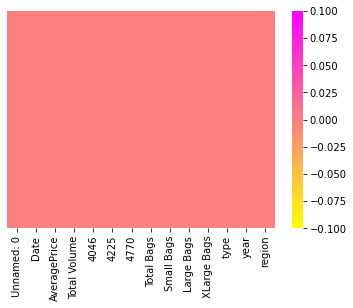

In [14]:
sns.heatmap(data.isnull(),yticklabels=False,cmap='spring_r')
data.isnull().values.sum()

### *Distinct types of avocados and the regions their cultivated and marketed are listed below*

In [15]:

data.region.unique()


array(['Albany', 'Atlanta', 'BaltimoreWashington', 'Boise', 'Boston',
       'BuffaloRochester', 'California', 'Charlotte', 'Chicago',
       'CincinnatiDayton', 'Columbus', 'DallasFtWorth', 'Denver',
       'Detroit', 'GrandRapids', 'GreatLakes', 'HarrisburgScranton',
       'HartfordSpringfield', 'Houston', 'Indianapolis', 'Jacksonville',
       'LasVegas', 'LosAngeles', 'Louisville', 'MiamiFtLauderdale',
       'Midsouth', 'Nashville', 'NewOrleansMobile', 'NewYork',
       'Northeast', 'NorthernNewEngland', 'Orlando', 'Philadelphia',
       'PhoenixTucson', 'Pittsburgh', 'Plains', 'Portland',
       'RaleighGreensboro', 'RichmondNorfolk', 'Roanoke', 'Sacramento',
       'SanDiego', 'SanFrancisco', 'Seattle', 'SouthCarolina',
       'SouthCentral', 'Southeast', 'Spokane', 'StLouis', 'Syracuse',
       'Tampa', 'TotalUS', 'West', 'WestTexNewMexico'], dtype=object)

In [16]:
data.type.unique()

array(['conventional', 'organic'], dtype=object)

### *Having the cleaned data,it's time to format it.Here the string 'Date' is formatted to standard date format , the price look up code is made explicitly and since the unamed column is redundant it is dropped.* 

In [3]:
data['Date'] = pd.to_datetime(data['Date'])
data.rename(columns={'year':'Year'}, inplace=True) 
data.rename(columns={'4046':'PLU 4046'}, inplace=True) 
data.rename(columns={'4225':'PLU 4225'}, inplace=True) 
data.rename(columns={'4770':'PLU 4770'}, inplace=True) 
data['Year'] = data['Date'].dt.year
data['Month'] = data['Date'].dt.month
data['Day'] = data['Date'].dt.day
data.drop('Unnamed: 0', axis=1, inplace=True)

### The PLU or Price Look-Up code is a 4- or 5-digit number that is primarily used on fresh produce items and will typically appear on a small sticker that is applied to an individual piece of fresh produce. The PLU code identifies produce items based upon the commodity, variety and size group.For the commodity "Avocados" it is given by :

- 4046: non-organic small/medium Hass Avocados (~3-5 oz) 
- 4225: non-organic large Hass Avocados (~8-10 oz) 
- 4770: non-organic extra large Hass Avocados (~10-15 oz) 
</br>

### The regular avocado has some great uses, but the Hass avocado makes more sense for most culinary purposes. The big difference: these avocados have significantly less fat.
### Now, less fat might sound good, but the fats found in Hass avocados are very healthy. Avocado oils are considered heart-healthy and good for your skin. A regular avocado has the same kind of fats but in much lower quantities.

In [4]:
data['Total Revenue'] = data['AveragePrice'] * data['Total Volume']
data['Total Revenue PLU 4046'] = data['AveragePrice'] * data['PLU 4046']
data['Total Revenue PLU 4225'] = data['AveragePrice'] * data['PLU 4225']
data['Total Revenue PLU 4770'] = data['AveragePrice'] * data['PLU 4770']
data['Total Revenue Small Bags'] = data['AveragePrice'] * data['Small Bags']
data['Total Revenue Large Bags'] = data['AveragePrice'] * data['Large Bags']
data['Total Revenue XLarge Bags'] = data['AveragePrice'] * data['XLarge Bags']

### The above code snippet calculates the revenues per feature basis with Average Price in the data frame.

### This is our finalised cleaned data!

In [33]:
data.head(5)

,Date,AveragePrice,Total Volume,PLU 4046,PLU 4225,PLU 4770,Total Bags,Small Bags,Large Bags,XLarge Bags,...,region,Month,Day,Total Revenue,Total Revenue PLU 4046,Total Revenue PLU 4225,Total Revenue PLU 4770,Total Revenue Small Bags,Total Revenue Large Bags,Total Revenue XLarge Bags
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,...,Albany,12,27,85434.7046,1378.8642,72424.9505,64.0528,11442.8146,124.0225,0.0
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,...,Albany,12,20,74083.9230,910.2780,60262.3935,78.7455,12700.8945,131.6115,0.0
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,...,Albany,12,13,109944.8046,739.0710,101509.1931,121.3650,7479.2553,95.9202,0.0
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,...,Albany,12,6,85311.5220,1222.5600,77734.5228,78.3864,6131.5920,144.4608,0.0
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,...,Albany,11,29,65330.6880,1205.0944,56113.1392,96.9984,7662.4128,253.0432,0.0


### *The histogram below indicates the data for each year that we have in total,from which it can be said the analysis had been halted by 2018*

(array([5615.,    0.,    0., 5616.,    0.,    0., 5722.,    0.,    0.,
        1296.]),
 array([2015. , 2015.3, 2015.6, 2015.9, 2016.2, 2016.5, 2016.8, 2017.1,
        2017.4, 2017.7, 2018. ]),
 <a list of 10 Patch objects>)

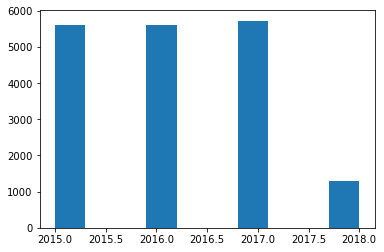

In [110]:
plt.hist(data['Year'])

## Descriptive Analysis [Word Cloud]

### Word clouds or tag clouds are graphical representations of word frequency that give greater prominence to words that appear more frequently in a source text. The larger the word in the visual the more common the word was in the document(s).

### *It is visually evident that the states Albany followed by Atlanta,Washington,Baltimore,Boston,Charlotte contributes prominently towards the marketing and the production of avocados in USA.*

(-0.5, 511.5, 383.5, -0.5)

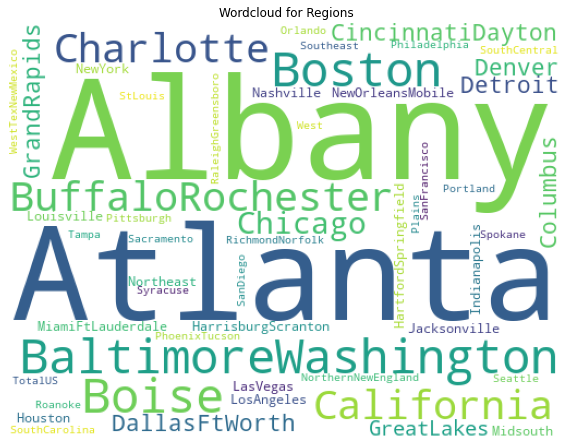

In [22]:
from wordcloud import WordCloud 
data_region = data.region.unique()
plt.subplots(figsize=(10,10))
wordcloud = WordCloud(
                          background_color='white',
                          width=512,
                          height=384
                         ).generate("*".join(data_region))
plt.imshow(wordcloud)
plt.title("Wordcloud for Regions")
plt.axis('off')

## EDA [Average Price]

### In the following code snippet,distinct region's or county's market price for avocados are studied and then they sorted and charted.

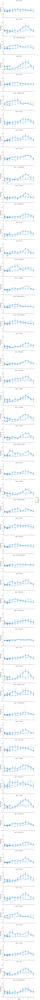

In [121]:
sns.factorplot('Month','AveragePrice',data=data,
               hue='Year',
               row='region',
               aspect=2,
               palette='Blues',
              )

### A factor plot is simply the same plot generated for different response and factor variables and arranged on a single page. The underlying plot generated can be any univariate or bivariate plot. 

### *Here each region with repect to the market price (on average) of avos is studied with the hue being the year os sale.*

Text(0.5, 1.0, 'Average Price of Avocado According to Region')

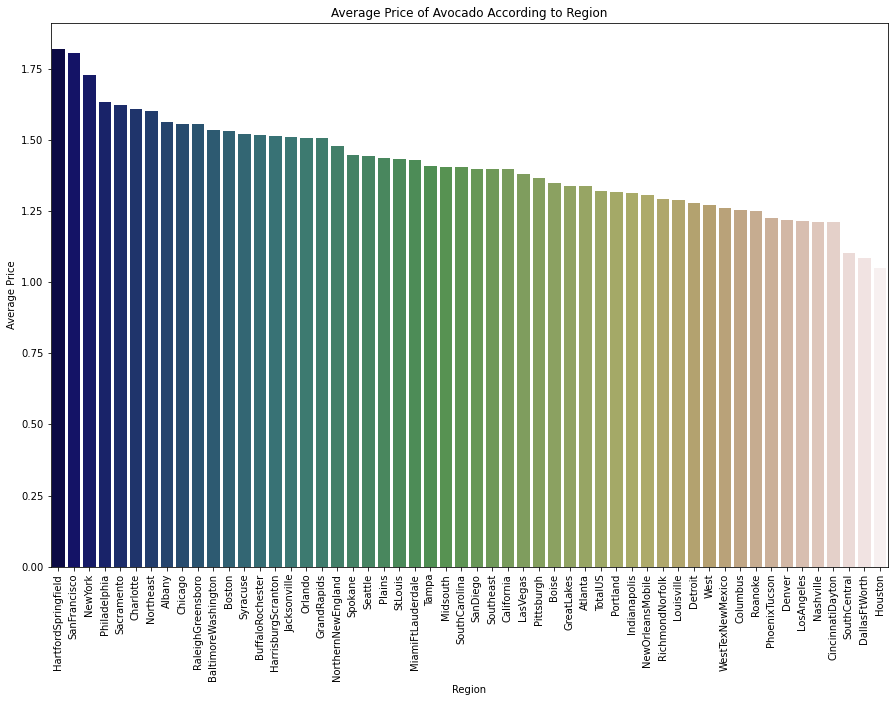

In [104]:
region_list=list(data.region.unique())
average_price=[]

for i in region_list:
    x=data[data.region==i]
    region_average=sum(x.AveragePrice)/len(x)
    average_price.append(region_average)

df1=pd.DataFrame({'region_list':region_list,'average_price':average_price})
new_index=df1.average_price.sort_values(ascending=False).index.values
sorted_data=df1.reindex(new_index)

plt.figure(figsize=(15,10))
ax=sns.barplot(x=sorted_data.region_list,y=sorted_data.average_price,palette='gist_earth')

plt.xticks(rotation=90)
plt.xlabel('Region')
plt.ylabel('Average Price')
plt.title('Average Price of Avocado According to Region')

## Regions. Where can I find more avos? and cheaper?

### *From the bar plot above, the avos's price is pretty much hooked up in Hattford Spring Field,San Francisco.Hence for cheaper avocados travel to Houstonand Dallas Ft. Worth*

## Organic vs Conventional

Text(0.5, 1.0, 'Average Price of Avocado According to Types')

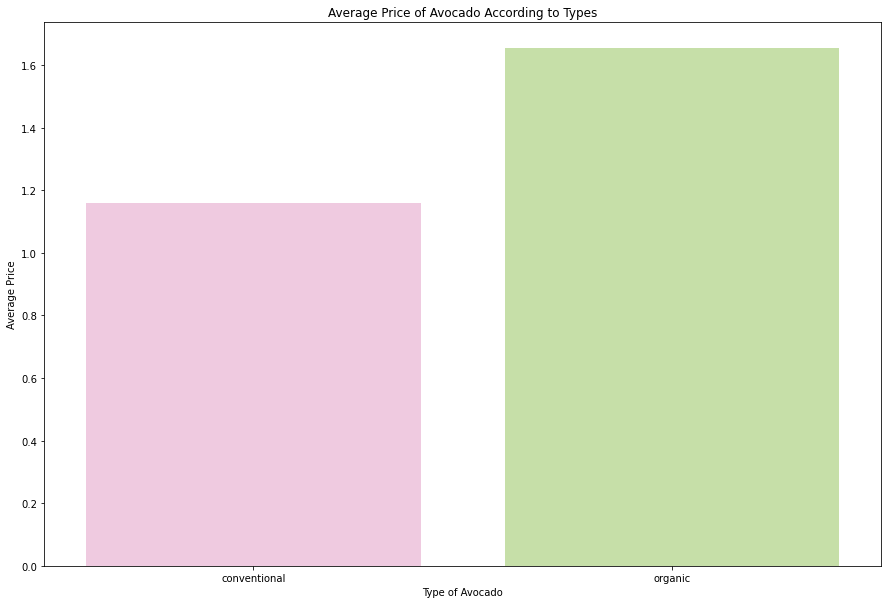

In [106]:
type_list=list(data.type.unique())
average_price2=[]

for i in type_list:
    x=data[data.type==i]
    average_price2.append(sum(x.AveragePrice)/len(x))
df2=pd.DataFrame({'type_list':type_list,'average_price':average_price2})

plt.figure(figsize=(15,10))
ax=sns.barplot(x=df2.type_list,y=df2.average_price,palette='PiYG')
plt.xlabel('Type of Avocado')
plt.ylabel('Average Price')
plt.title('Average Price of Avocado According to Types')

###  From the bar plot,it is seen that the natural i.e, the organic avocados have a higher market rate than the conventional (MNC produced) 

### Organic food does not allow the use of artificial fertilisers and pesticides. Therefore, farmers may have to rely on more labour-intensive methods of weed control/pest control. More crops may be lost due to disease pest, so the output is lower than conventional products.

Text(0.5, 1.0, 'Avg Price of avocado as per type on avocado over time')

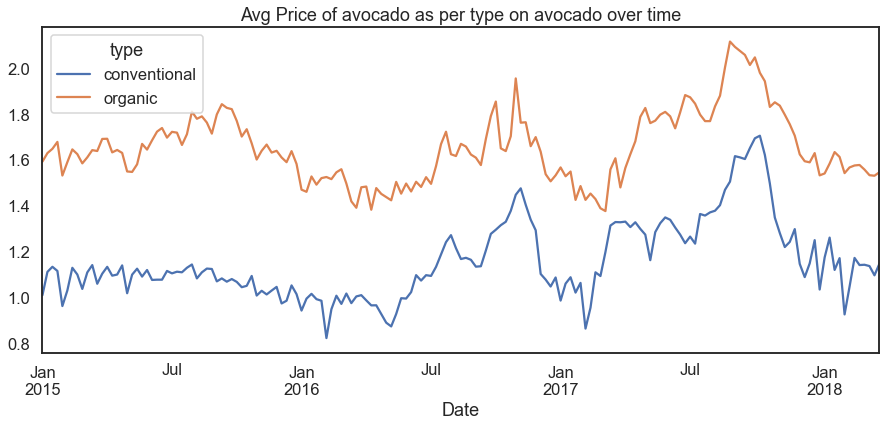

In [55]:
fig,ax = plt.subplots(figsize=(15,6))
data.groupby(['Date','type']).mean()['AveragePrice'].unstack().plot(ax=ax)
plt.title('Avg Price of avocado as per type on avocado over time')

### Avocados are usually grown from spring through fall, but in some places can be grown year-round.

### *The line plot ,exhibits the trends of rise and fall of the prices throught 2018 for both the types, though they appear to show the same trend, near closure to 2017,it is obsereved that, there had been sudden demand and loss for the conventional type and by Feb ,2018 the organic had been preferred than the latter.*

### Through clever marketing, avocado sales increased and its crop value spiked by nearly 70%. Once an odd and obscure fruit, today you would now be hard-pressed to find someone who didn't know what an avocado was. For instance, this past Super Bowl Sunday alone, Americans ate 105 million pounds of avocados.

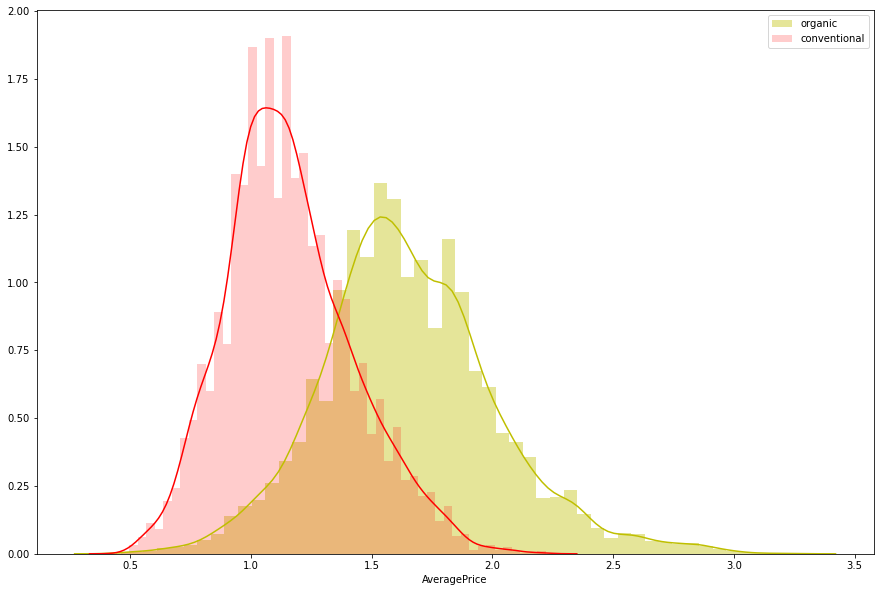

In [71]:
plt.figure(figsize=(15,10))
sns.distplot(data[data["type"] == "organic"]["AveragePrice"], color="y", label="organic")
sns.distplot(data[data["type"] == "conventional"]["AveragePrice"], color="r", label="conventional", 
             hist_kws={"alpha": 0.2})
plt.legend()

### Seaborn distplot lets you show a histogram with a line on it. 
### The x-axis is the value of the variable just like in a histogram and the y-axis in a density plot is the probability density function for the kernel density estimation.

### *It can be inferred that from the x-axis,the extremum of the organic is around 3 dollars, and conventional being 2 dollars, and since the latter is availabe for cheaper rate, people tend to consume it more than the organic.Affordability reflects the conomy!!!*  

In [ ]:
## Are organic avos gaining popularity?

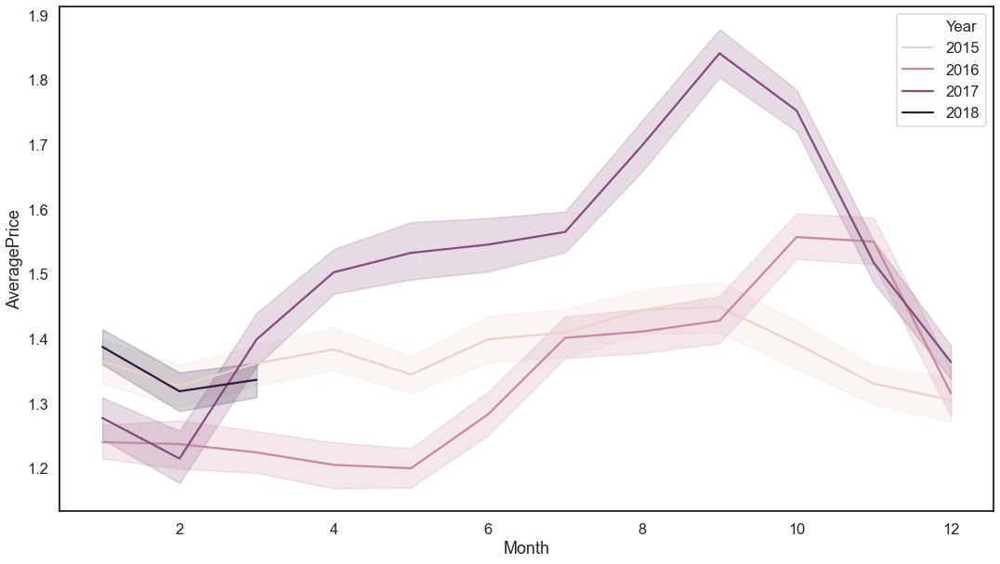

In [130]:
plt.figure(figsize=(18,10))
sns.lineplot(x="Month", y="AveragePrice", hue='Year',  data=data)
plt.show()

### The relationship between x and y can be shown for different subsets of the data using the hue, size, and style parameters. These parameters control what visual semantics are used to identify the different subsets

### *As we had our data explained in the previos bar-plot,year 2018 had been half-halted. Here, it is evident that in the year 2017, around October there had been a peek at the average price of the avos (clear cut of clever marketing strategies + nutritional awareness). Since the avos did not gain it's popularity through marketing globally,it had shown a stability in 2015.Similar trends are observed as in 2017 in 2016.*

### For further study , do visit :
- https://www.washingtonpost.com/news/food/wp/2017/05/02/avocado-prices-are-at-a-record-high-just-in-time-for-cinco-de-mayo/
- https://money.cnn.com/2017/09/09/news/economy/avocado-prices-soar/index.html

## Does bag size depicts the secrete ?

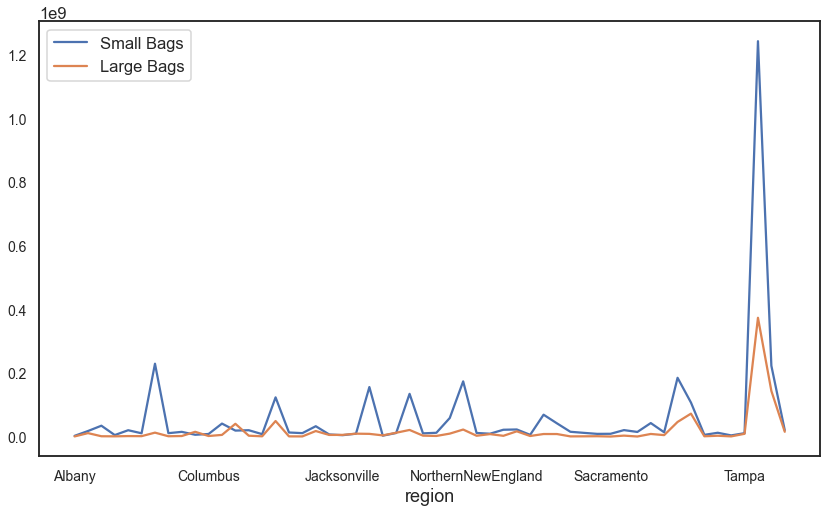

In [126]:
Bags = data[['Small Bags', 'Large Bags']].groupby(data.region).sum()
Bags.plot(kind='line', fontsize = 14,figsize=(14,8))
plt.show()

### *Tampa is really a whole consumer!!*

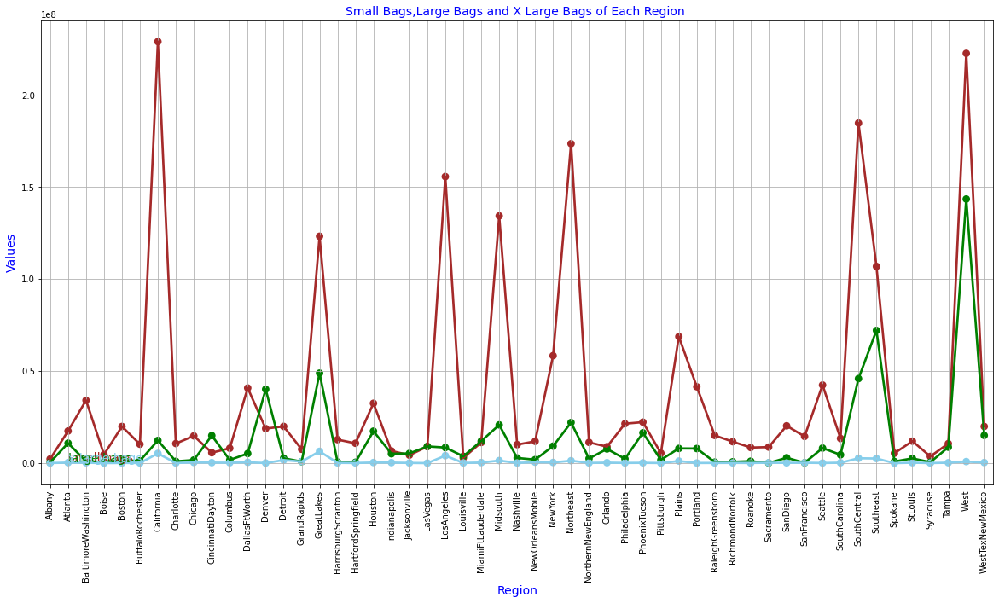

In [109]:
small=[]
large=[]
xlarge=[]


for i in region_list:
    x=data[data.region==i]
    small.append(sum(x['Small Bags']))
    large.append(sum(x['Large Bags']))
    xlarge.append(sum(x['XLarge Bags']))
df5=pd.DataFrame({'region_list':region_list,'small':small,'large':large,'xlarge':xlarge})

f,ax1=plt.subplots(figsize=(20,10))
sns.pointplot(x=region_list,y=small,data=df5,color='brown',alpha=0.7)
sns.pointplot(x=region_list,y=large,data=df5,color='green',alpha=0.7)
sns.pointplot(x=region_list,y=xlarge,data=df5,color='skyblue',alpha=0.7)

plt.xticks(rotation=90)
plt.text(1,770000,'small bags',color='brown',fontsize=14)
plt.text(1,615000,'large bags',color='green',fontsize=14)
plt.text(1,500000,'x large bags', color='skyblue',fontsize=14)

plt.xlabel('Region',color='blue',fontsize=14)
plt.ylabel('Values',color='blue',fontsize=14)
plt.title('Small Bags,Large Bags and X Large Bags of Each Region ',color='blue',fontsize=14)
plt.grid()

### *The size of purchase tells how much darely we consume it!!  Here, California followed by the West depicts the citizen's daily consumption of avos than the other states. States like Spokane, St.Louis and Syracuse had turned their pages on the other mystery fruit!!* 

## Volume Distribution

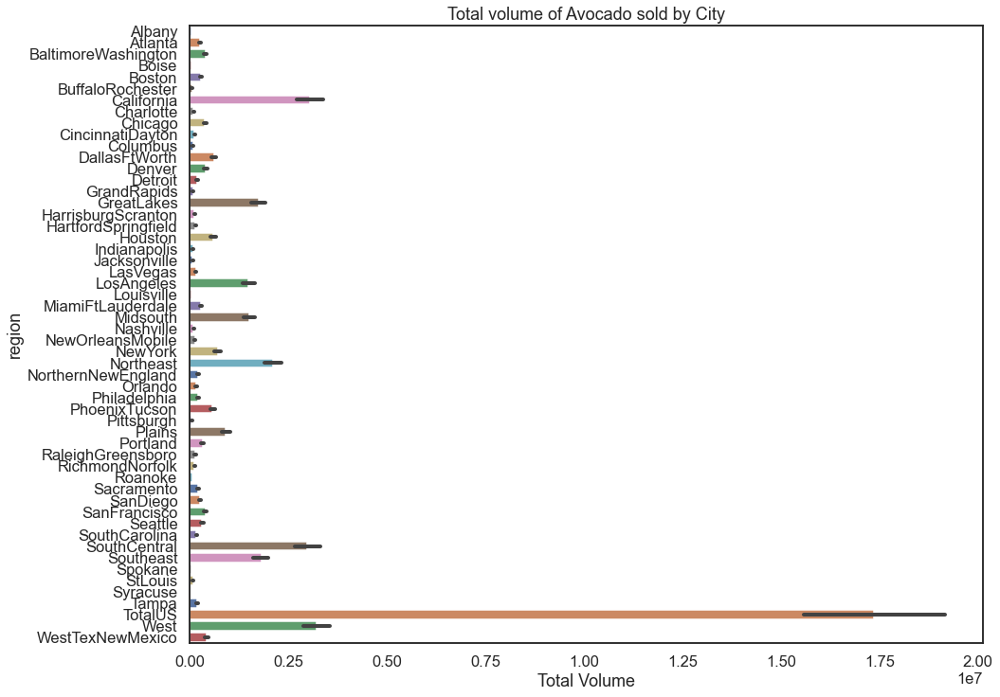

In [53]:
plt.figure(figsize=(15,12))
sns.set(style="white", context="talk")
plt.title("Total volume of Avocado sold by City")
sns.barplot(x="Total Volume",y="region",data= data,palette="deep")

### A bullet graph is a variation of a bar graph developed to replace dashboard gauges and meters. A bullet graph is useful for comparing the performance of a primary measure to one or more other measures.

###  *Excluding the TotalUS, California,South Central and the West ranks for higher production of Avos in the market! These states symbolises a functional authority to the avo farmes in USA.With the least participation of the farmer-market relationship in Spokane,Syracuse, Louisville,Albany and Boise!*

Text(0.5, 1.0, 'Average of Total Volume According to Region')

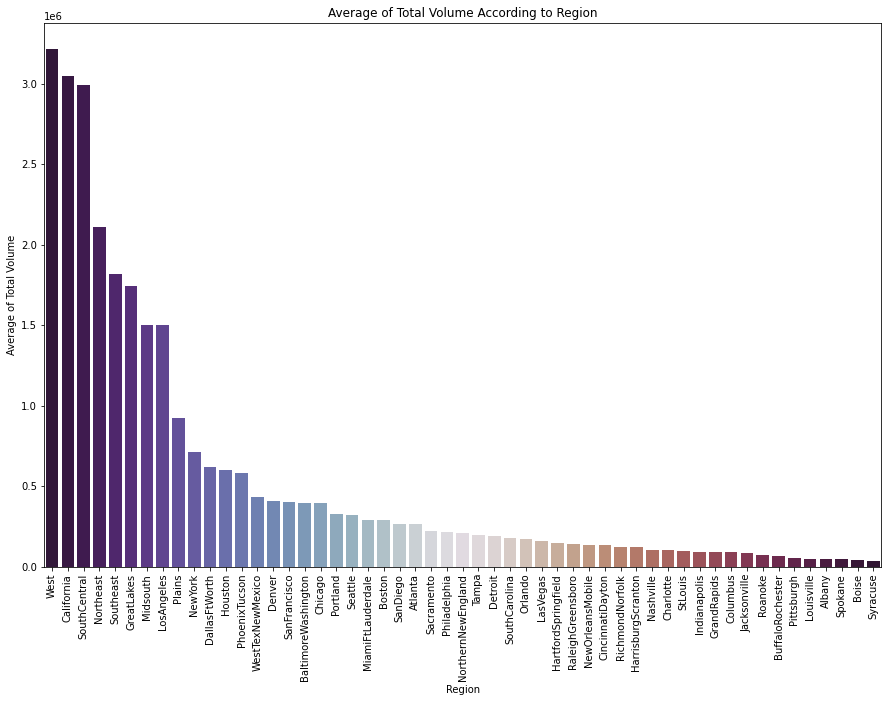

In [107]:
filter1=data.region!='TotalUS'
data1=data[filter1]

region_list=list(data1.region.unique())
average_total_volume=[]

for i in region_list:
    x=data1[data1.region==i]
    average_total_volume.append(sum(x['Total Volume'])/len(x))
df3=pd.DataFrame({'region_list':region_list,'average_total_volume':average_total_volume})

new_index=df3.average_total_volume.sort_values(ascending=False).index.values
sorted_data1=df3.reindex(new_index)

plt.figure(figsize=(15,10))
ax=sns.barplot(x=sorted_data1.region_list,y=sorted_data1.average_total_volume,palette='twilight_shifted')

plt.xticks(rotation=90)
plt.xlabel('Region')
plt.ylabel('Average of Total Volume')
plt.title('Average of Total Volume According to Region')

### *A more clear-cut visualisation than the previous graph, of the quantity of avocados sold by region!*

### The part to whole relationship is studied yearwise (2015~2018) !

Text(0, 0.5, '')

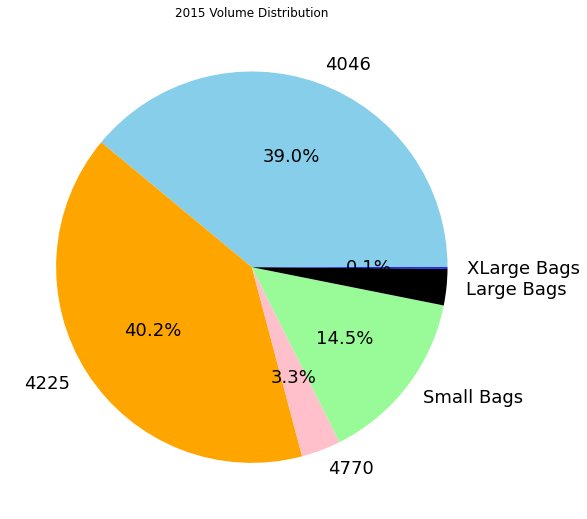

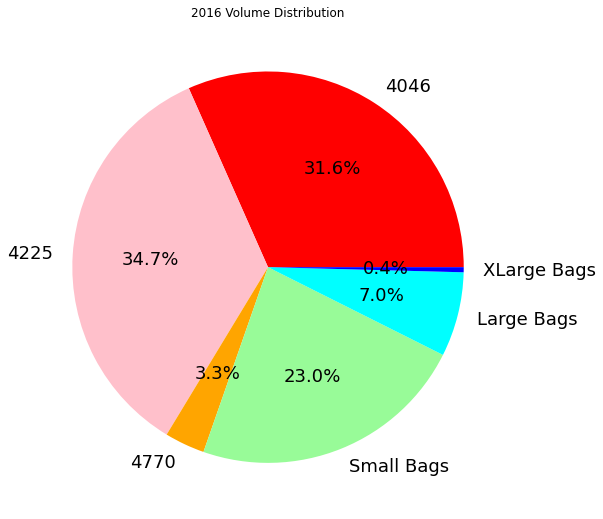

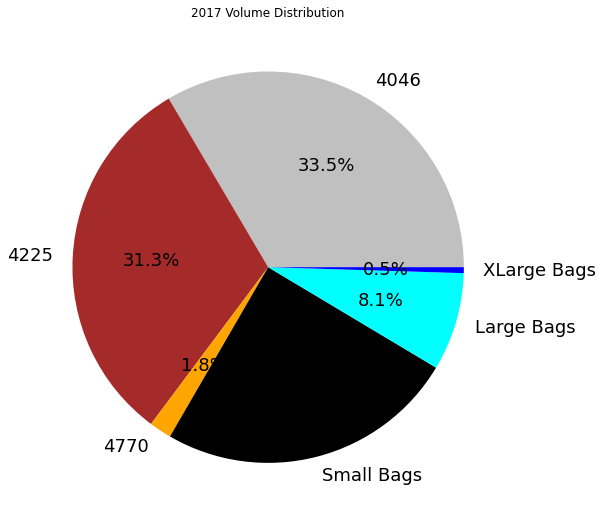

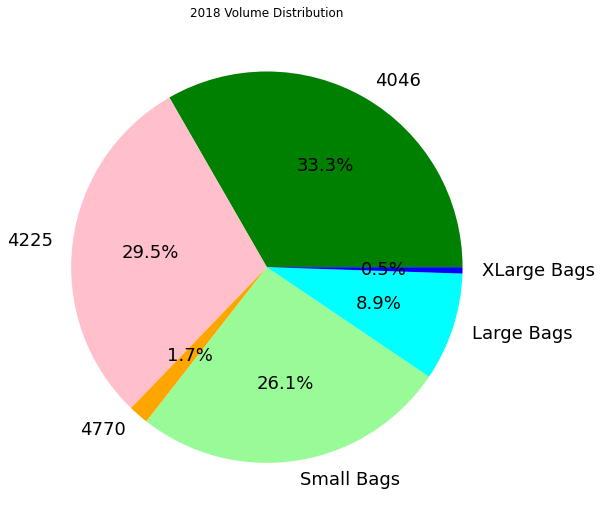

In [22]:
data_to_plot = data.drop(['Date','AveragePrice', 'Total Volume', 'Total Bags','type','region','Month','Day'], axis = 1).groupby('year').agg('sum')
index = ['4046', '4225', '4770', 'Small Bags', 'Large Bags', 'XLarge Bags']
series = pd.DataFrame({'2015': data_to_plot.loc[[2015],:].values.tolist()[0],
                      '2016': data_to_plot.loc[[2016],:].values.tolist()[0],
                      '2017': data_to_plot.loc[[2017],:].values.tolist()[0],
                      '2018': data_to_plot.loc[[2018],:].values.tolist()[0]}, index=index)
series.plot.pie(y='2015',figsize=(9, 9), autopct='%1.1f%%', colors=['skyblue', 'orange', 'pink', 'palegreen', 'black', 'blue'], fontsize=18, legend=False, title='2015 Volume Distribution').set_ylabel('')
series.plot.pie(y='2016',figsize=(9, 9), autopct='%1.1f%%', colors=['red', 'pink', 'orange', 'palegreen', 'aqua', 'blue'], fontsize=18, legend=False, title='2016 Volume Distribution').set_ylabel('')
series.plot.pie(y='2017',figsize=(9, 9), autopct='%1.1f%%', colors=['silver', 'brown', 'orange', 'black', 'aqua', 'blue'], fontsize=18, legend=False, title='2017 Volume Distribution').set_ylabel('')
series.plot.pie(y='2018',figsize=(9, 9), autopct='%1.1f%%', colors=['green', 'pink', 'orange', 'palegreen', 'aqua', 'blue'], fontsize=18, legend=False, title='2018 Volume Distribution').set_ylabel('')

### The three most important features in our case study is studied below using a correlation matrix.

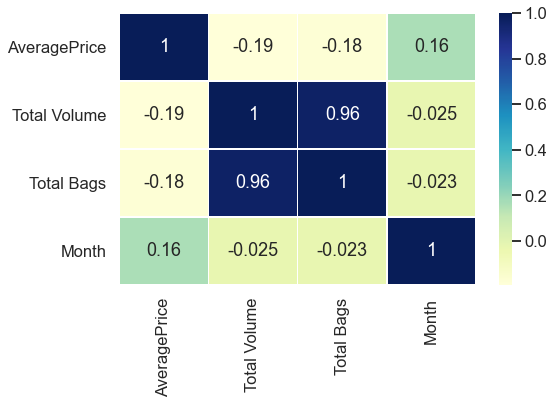

In [76]:
data_corr = data[['AveragePrice','Total Volume','Total Bags','Month']]
correlations = data_corr.corr()
plt.figure(figsize=(8,5))
sns.heatmap(correlations,annot=True,cmap="YlGnBu",linewidths=.5)

### Correlation coefficients are indicators of the strength of the linear relationship between two different variables, x and y. A linear correlation coefficient that is greater than zero indicates a positive relationship. A value that is less than zero signifies a negative relationship. Finally, a value of zero indicates no relationship between the two variables x and y.



### *Here the price is negatively correlated with volume and bag [considered far than independent], and the volume and bags seem to be highly positvely correlated reflecting their inter-dependencies.*

## Multivariate analysis

In [5]:
import plotly.express as px

In [6]:
fig = px.sunburst(data, path=['region','AveragePrice'], values='Total Volume',color='PLU 4046')
fig.show()

### Sunburst plots visualize hierarchical data spanning outwards radially from root to leaves.The root starts from the center and children are added to the outer rings. Here region according to the cost they label on Avocados is illustrated witht the child being the PLU 4046, as introduced in the beginnig section.

</br>

### Produce labeled with PLU codes eliminates the need for grocery store checkers and customers to visually identify different varieties, which can make check-out and inventory control easier, faster, and more accurate – something that is important when varieties of produce look similar but have different prices.Hence the bar plot is observed from the available PLU data for avos.

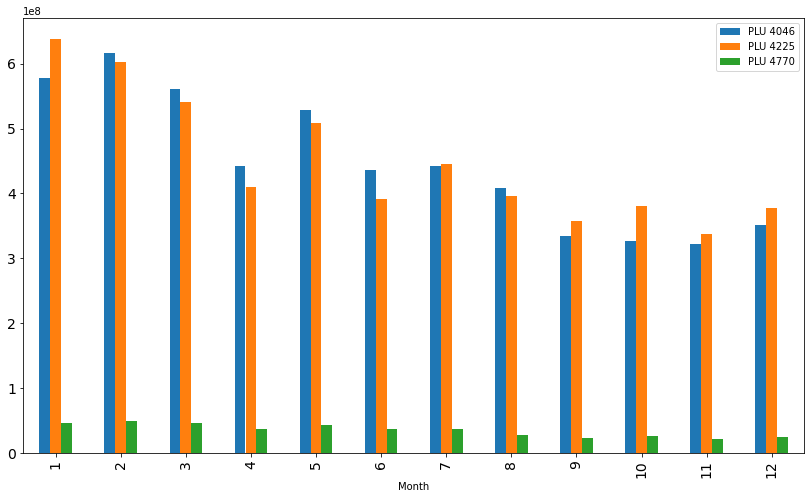

In [30]:
variant = data[['PLU 4046', 'PLU 4225', 'PLU 4770']].groupby(data.Month).sum()
variant.plot(kind='bar', fontsize = 14, figsize=(14,8))

In [7]:
fig3 = px.treemap(data, path=['region'], values='Total Revenue',
                  color='AveragePrice', hover_data=['Total Volume'])
fig3

### Hierarchical data are often stored as a rectangular dataframe, with different columns corresponding to different levels of the hierarchy. px.treemap can take a path parameter corresponding to a list of columns.

### *This tree-map deploys the region including the total USA by the size of Total revenue genrated (indicator of a stable + profitable economy and the color indicating the average price of those regions.I n this case i.e, Revenue Northeast seems to beat the rest pretty well followed by the Baltimore Washington!*

## A geo-spatial visualisation

</br>

### *The below code snippet redirects to the world-wide market distributions of the avocados with the color representing it's market strength/density.*

In [16]:
import webbrowser
webbrowser.open("http://www.avocadosource.com/world.asp")

True

In [11]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

df = pd.read_csv("production.csv",
                   dtype={"fips": str})


fig = px.choropleth(df, geojson=counties, locations='fips', color='production',
                           color_continuous_scale="magma",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'Production':'Yield'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
64.835365, -147.776749
fig.show()

### *The above is a USA- base map,with the color indicating the strength of avos sales across the region*

## Deploy the dash!!!!

### *Next we will look on to the dashboards created for this avocado's case study!*